# Plan
- Import Libs
- Import Data
- Exploratory Data Analysis
    - Univariate Analysis
    - Bivariate Analysis 
- Feature Engineering (Selection)
- Models Training 
- Optimal Model Selection
- Optimal Model Evaluation and Optimization
- Conclusion
        A.Belfkih@HPS-CASA
        DPT INFO - ENSMR

## Import Libs

In [1]:
## Loading Libs
import numpy as np    ## Scientific lib for Matrix manipulation
import sklearn as sk  ## Machine Learning Lib
import pandas as pd   ## data manipulation Lib
import seaborn as sns ##  visualization library based on matplotlib
%matplotlib inline
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix

In [2]:
## Evaluation Metrics
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

## Import Data

In [3]:
## Import Dataset
df = pd.read_csv('C:/Users/VonGola/Downloads/Compressed/creditcard.csv', low_memory=False)

## Exploratory Data Analysis

In [4]:
## Apercu 
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [5]:
## distribution de classes 
df.Class.value_counts()

0    284315
1       492
Name: Class, dtype: int64

In [6]:
## Description Statistique du dataset
df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.165980e-15,3.416908e-16,-1.373150e-15,2.086869e-15,9.604066e-16,1.490107e-15,-5.556467e-16,1.177556e-16,-2.406455e-15,...,1.656562e-16,-3.444850e-16,2.578648e-16,4.471968e-15,5.340915e-16,1.687098e-15,-3.666453e-16,-1.220404e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


la dataset est très déséquilibré


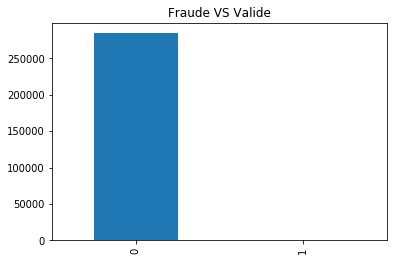

In [11]:
##distribution des class (Visual)
columns=df.columns
features_columns=columns.delete(len(columns)-1)
features=df[features_columns]
labels=df['Class']
count_classes = pd.value_counts(df['Class'], sort = True).sort_index()
count_classes.plot(kind = 'bar')
plt.title('Fraude VS Valide')
print("la dataset est très déséquilibré")

### Univariate Analysis 
(exploring a single variable or attribute at a time)

c:\users\vongola\appdata\local\programs\python\python35\lib\site-packages\matplotlib\axes\_axes.py:6448: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


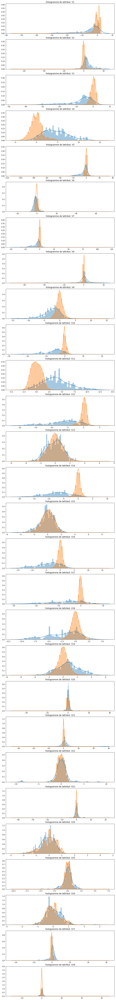

In [12]:
## Fraud vs Valid Distribution for each variable
features = df.iloc[:,1:29].columns
plt.figure(figsize=(12,28*4))
gs = gridspec.GridSpec(28, 1)
for i, cn in enumerate(df[features]):
    ax = plt.subplot(gs[i])
    sns.distplot(df[cn][df.Class == 1], bins=50)
    sns.distplot(df[cn][df.Class == 0], bins=50)
    ax.set_xlabel('')
    ax.set_title('histogramme de l''attribut: ' + str(cn))
plt.show()

c:\users\vongola\appdata\local\programs\python\python35\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


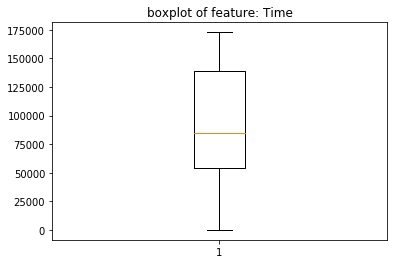

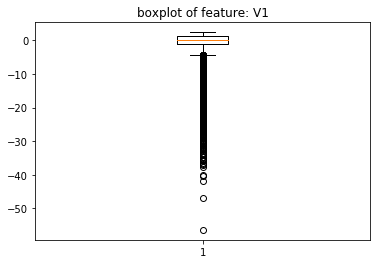

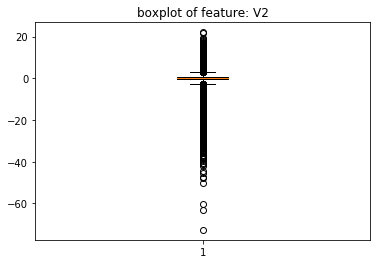

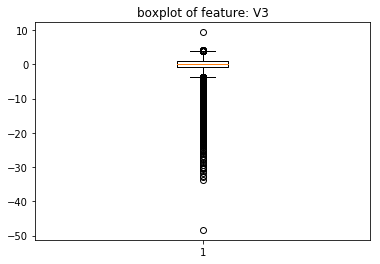

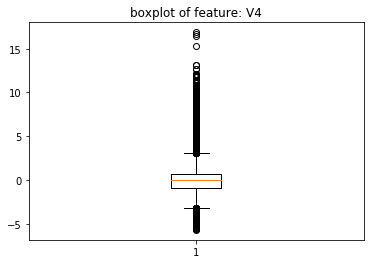

...

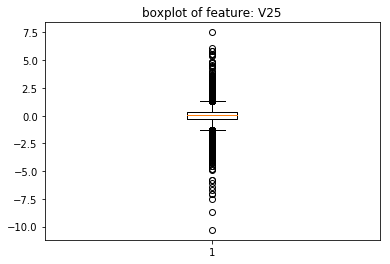

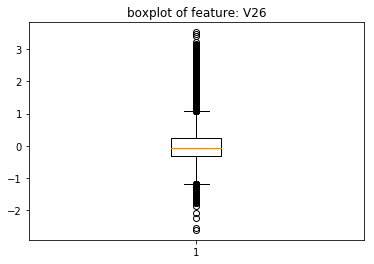

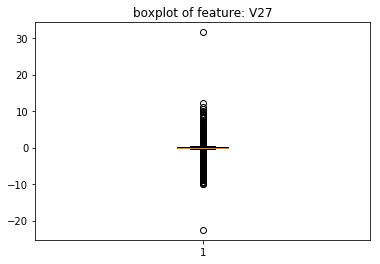

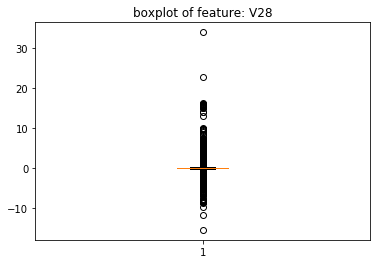

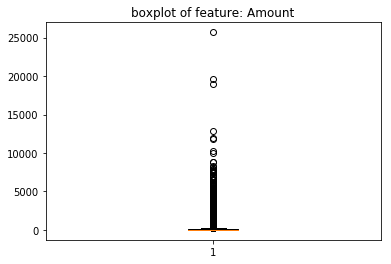

In [11]:
## Boxplots for each variable
features=df[features_columns]
for ss in features :
    fig=plt.figure()
    ax=fig.add_subplot(1,1,1)
    ax.set_title('boxplot de l"attribut: ' + ss)
    ax.boxplot(df[ss])
    plt.show

c:\users\vongola\appdata\local\programs\python\python35\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<Figure size 432x288 with 0 Axes>

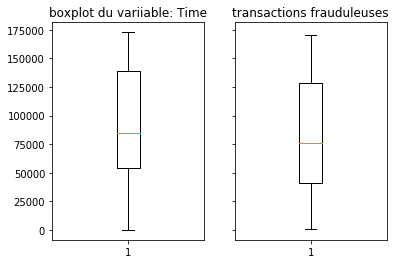

<Figure size 432x288 with 0 Axes>

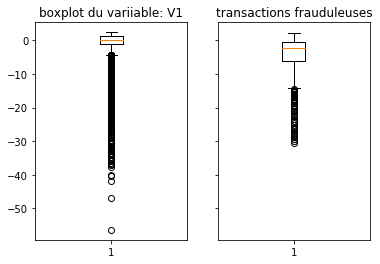

<Figure size 432x288 with 0 Axes>

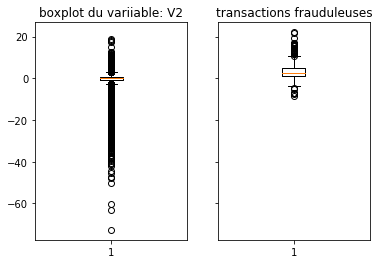

<Figure size 432x288 with 0 Axes>

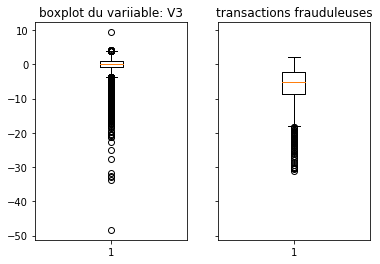

<Figure size 432x288 with 0 Axes>

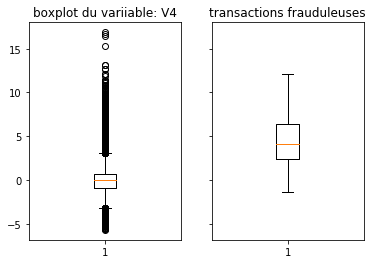

<Figure size 432x288 with 0 Axes>

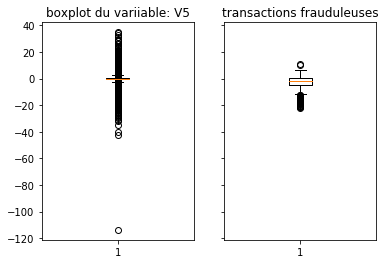

<Figure size 432x288 with 0 Axes>

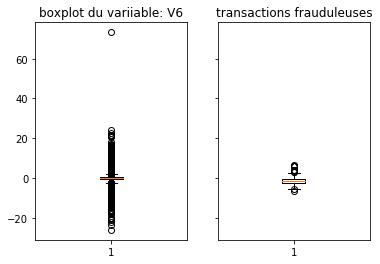

<Figure size 432x288 with 0 Axes>

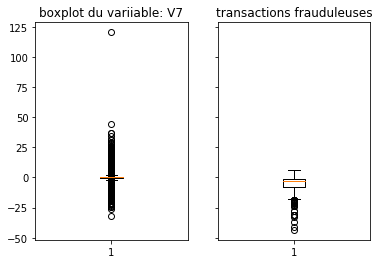

<Figure size 432x288 with 0 Axes>

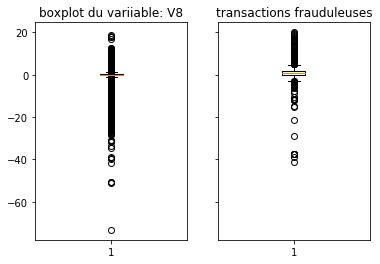

<Figure size 432x288 with 0 Axes>

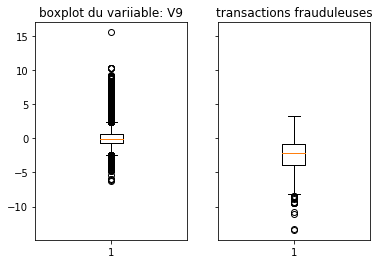

<Figure size 432x288 with 0 Axes>

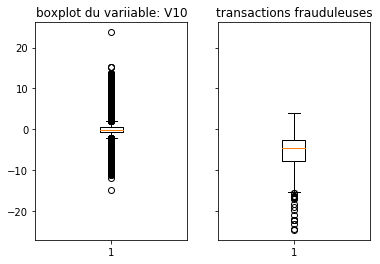

<Figure size 432x288 with 0 Axes>

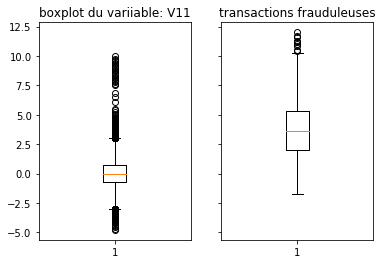

<Figure size 432x288 with 0 Axes>

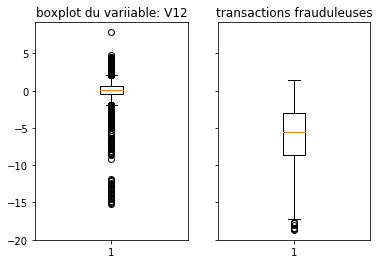

<Figure size 432x288 with 0 Axes>

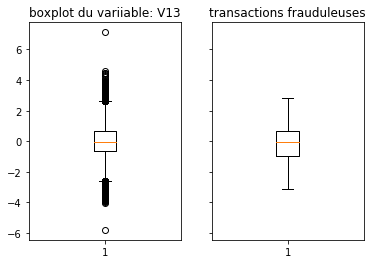

<Figure size 432x288 with 0 Axes>

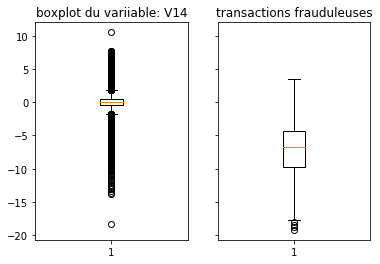

<Figure size 432x288 with 0 Axes>

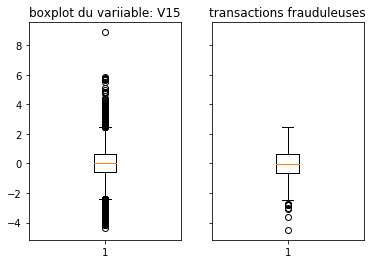

<Figure size 432x288 with 0 Axes>

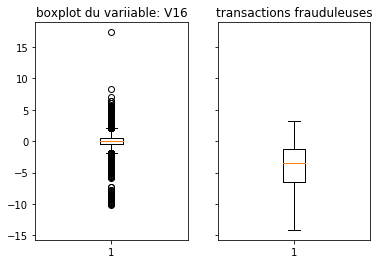

<Figure size 432x288 with 0 Axes>

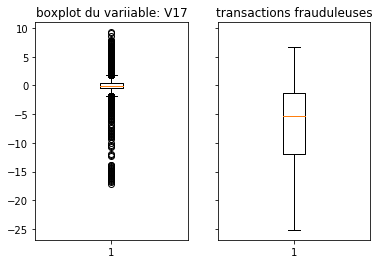

<Figure size 432x288 with 0 Axes>

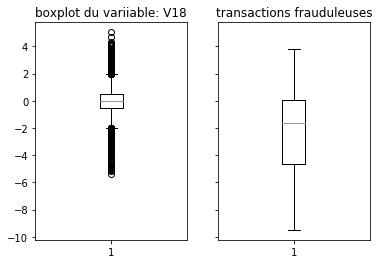

<Figure size 432x288 with 0 Axes>

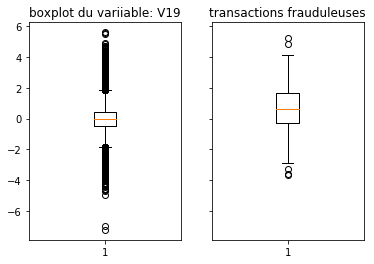

<Figure size 432x288 with 0 Axes>

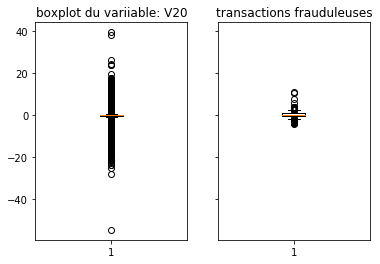

<Figure size 432x288 with 0 Axes>

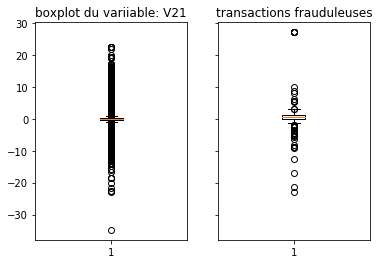

<Figure size 432x288 with 0 Axes>

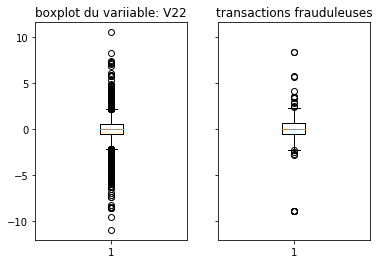

<Figure size 432x288 with 0 Axes>

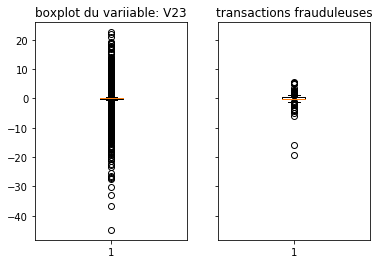

<Figure size 432x288 with 0 Axes>

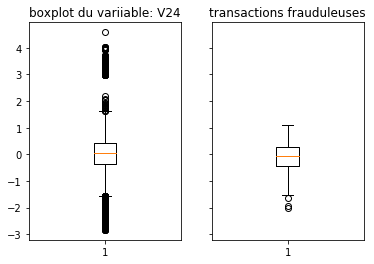

<Figure size 432x288 with 0 Axes>

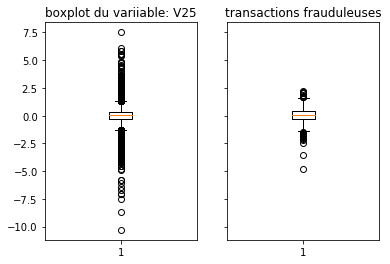

<Figure size 432x288 with 0 Axes>

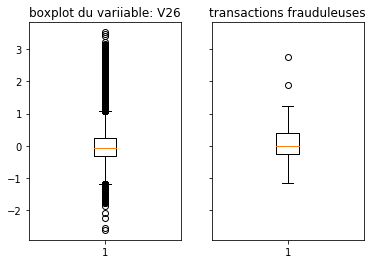

<Figure size 432x288 with 0 Axes>

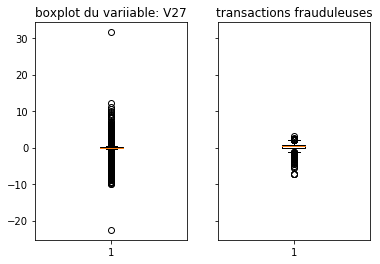

<Figure size 432x288 with 0 Axes>

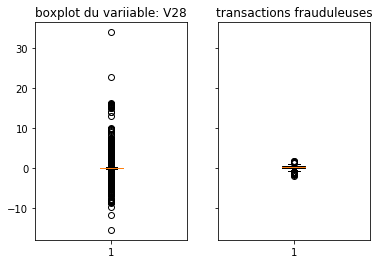

<Figure size 432x288 with 0 Axes>

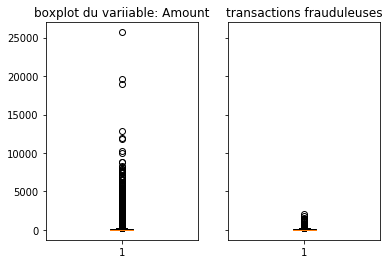

In [13]:
## BoxPlots for Fraud Vs Valid trans
dfnf = df.drop(df[df.Class==1].index)
dff = df.drop(df[df.Class==0].index)
features=dfnf[features_columns]
for ss in features :
    fig=plt.figure()
    f, (ax1, ax2) = plt.subplots(1, 2, sharey=True)
    ax1.boxplot(dfnf[ss])
    ax2.boxplot(dff[ss])
    ax1.set_title('boxplot du variiable: ' + ss)
    ax2.set_title('transactions frauduleuses')
    f.subplots_adjust(hspace=0.3)
    plt.show

## Bivariate Analysis

In [20]:
## Due to the rediculously huge dataset we can't plot a bivariate scatter matrix with our current hardware
## Thus we'll be analysing random samples from our dataset
df.drop(df[df.Class==1].index)
dfsample=df.sample(frac=0.01)

dfsample.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,...,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000,2848.000000
mean,95180.052317,0.019238,0.027535,-0.001123,-0.017829,0.001248,-0.021069,-0.027907,0.022029,-0.039664,...,0.008166,0.006942,0.003000,-0.000966,0.002411,-0.013494,0.000660,-0.007592,83.038904,0.002107
std,47236.097660,1.903719,1.615679,1.548222,1.418552,1.384039,1.318648,1.260363,1.120509,1.069403,...,0.747762,0.724834,0.488305,0.606334,0.512642,0.479763,0.367763,0.255584,223.125344,0.045859
min,41.000000,-26.457745,-17.645813,-30.177317,-4.492167,-17.892600,-9.847370,-31.197329,-23.464595,-9.462573,...,-8.755698,-8.420246,-8.743749,-1.873075,-2.422429,-1.345429,-7.263482,-4.798568,0.000000,0.000000
25%,54341.000000,-0.921765,-0.570011,-0.836472,-0.880993,-0.686922,-0.766452,-0.554880,-0.196978,-0.669248,...,-0.217143,-0.528461,-0.165313,-0.344077,-0.333668,-0.338728,-0.069139,-0.051861,5.000000,0.000000
50%,84580.500000,0.025590,0.089707,0.173057,-0.029836,-0.049124,-0.279494,0.049261,0.031304,-0.098872,...,-0.020825,0.025606,-0.017906,0.049967,0.026748,-0.078374,0.005542,0.010713,21.540000,0.000000
75%,140270.000000,1.332653,0.821946,1.015061,0.763787,0.602264,0.421179,0.555990,0.335508,0.562991,...,0.177309,0.542264,0.150956,0.447014,0.360523,0.219857,0.096903,0.074113,75.882500,0.000000
max,172782.000000,2.361810,16.497472,3.594708,8.995325,16.625394,7.422263,9.710941,9.435084,6.152975,...,22.565680,3.460893,4.608302,3.962197,2.178768,2.435498,2.496317,1.824300,4276.820000,1.000000


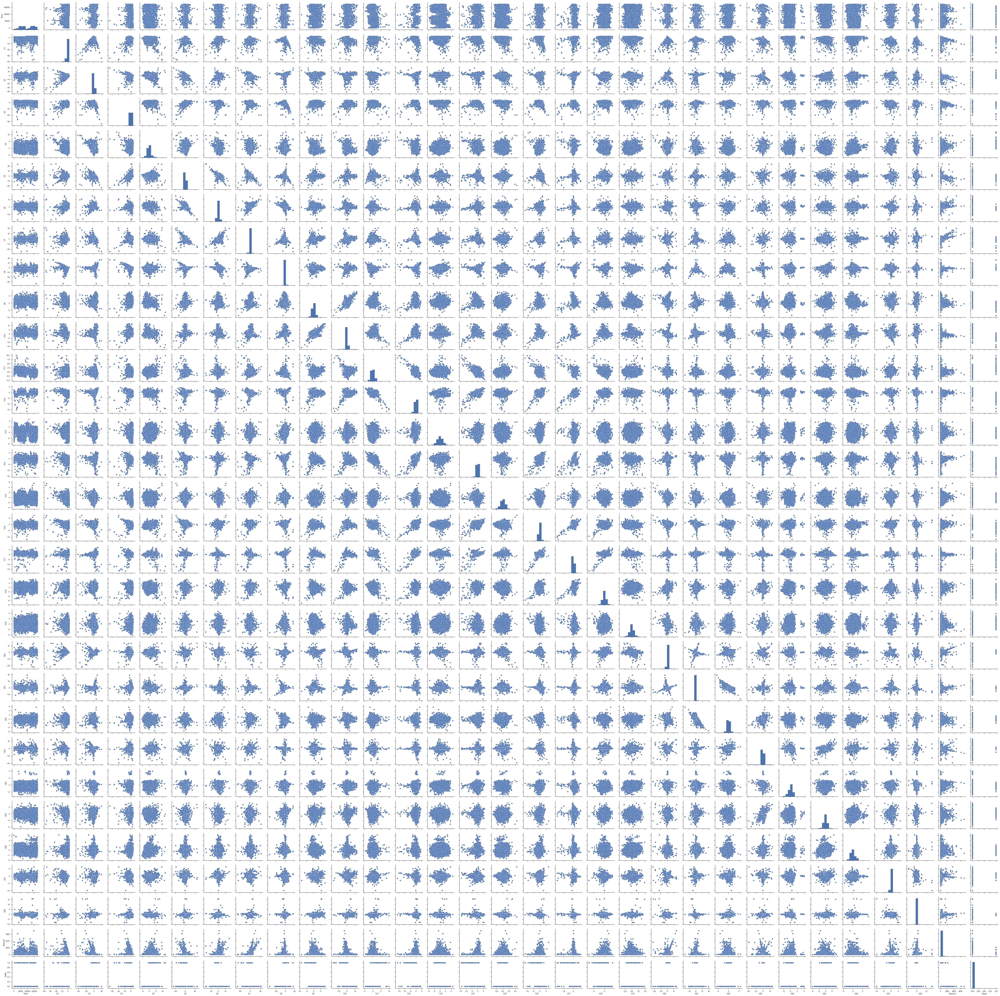

In [8]:
## Scatter Matrix plots
sns.set(style="ticks")
sns.pairplot(dfsample)
plt.show()

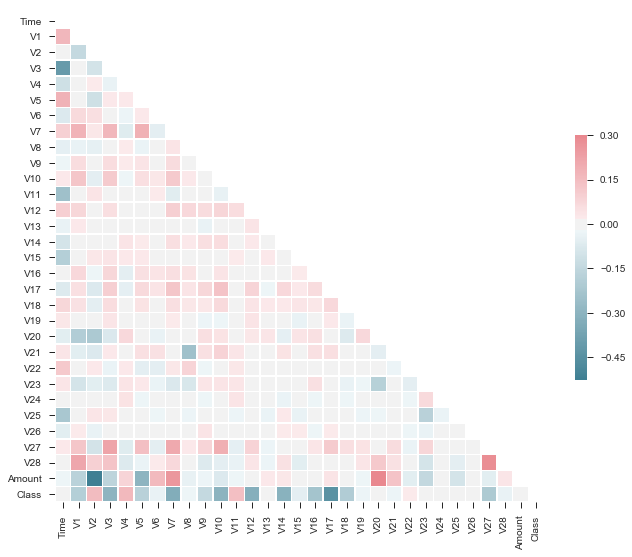

In [21]:
# Compute the correlation matrix
dfsample.apply(pd.to_numeric)
corr = dfsample.corr()
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

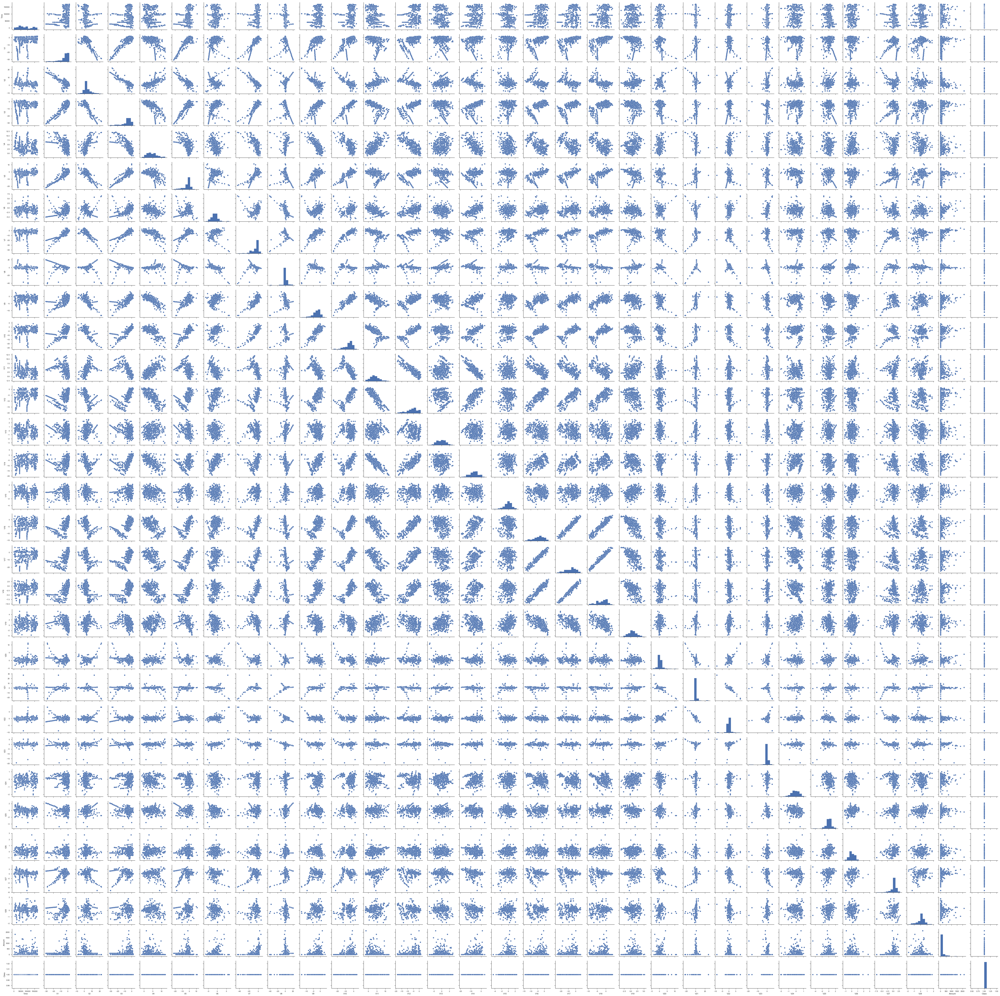

In [5]:
## scaatter matrix for fraudulent transactions
dfsample= df.drop(df[df.Class==0].index)
sns.set(style="ticks")
sns.pairplot(dfsample)
plt.show()

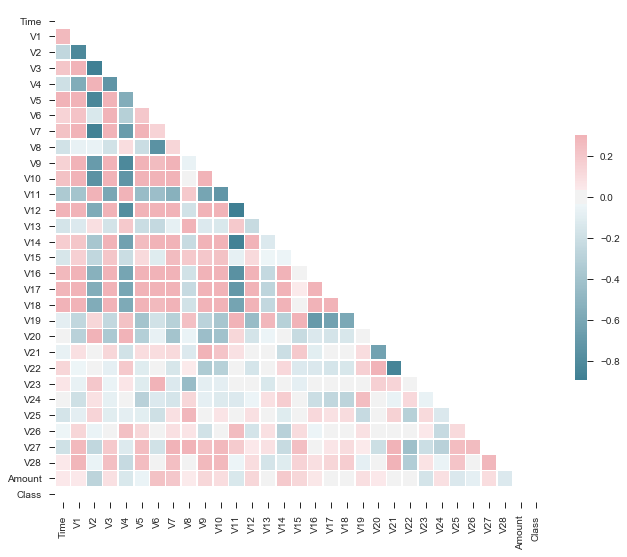

In [6]:
corr = dfsample.corr()
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [60]:
## extrait
from numpy import *
a=df['V18'].apply(pd.to_numeric)
b=df['V17'].apply(pd.to_numeric)
corrcoef([a,b])

array([[ 1.00000000e+00, -5.24946893e-15],
       [-5.24946893e-15,  1.00000000e+00]])

## Remarks and Conclusion

# Feature Engineering
 - Features Selection
 - OverSampling
 - UnderSampling
 - Threeway Split

In [4]:
#Dropping Irrelevent Variables
# ecarter les attributs qu’on jugé inutiles pour nos algorithmes d'apprentissage
df = df.drop(['V28','V27','V26','V25','V24','V23','V20','V15','V13','V8'], axis =1)

## Threeway Split
    60 % Training set
    20 % Testing set
    20 % Validation set

In [5]:
train, validate, test = np.split(df.sample(frac=1), [int(.6*len(df)), int(.8*len(df))])
print(len(train))
print(len(validate))
print(len(test))

170884
56961
56962


## OverSampling

In [6]:
dfOS=train

In [7]:
# OverSampled Dataframe prep for Training Validation and Testing

model_variables = ['Time', 'V1','V2','V3','V4','V5','V6','V7','V9','V10','V11','V12',
                   'V14','V16','V17','V18','V19','V21','V22','Amount', 'Class']

df_data_relevent = dfOS[model_variables]


In [8]:
from sklearn.model_selection import train_test_split
training_features, test_features, \
training_target, test_target, = train_test_split(df_data_relevent.drop(['Class'], axis=1),
                                               df_data_relevent['Class'],
                                               test_size = 0,
                                               random_state=12)

In [9]:
from imblearn.over_sampling import SMOTE
## with over sampling we up the rate of fraudulent data in training set to 20% from the meager 0.173047500131896 %
sm = SMOTE(random_state=12, ratio =0.3,k_neighbors=4)
X_os, y_os = sm.fit_sample(training_features, training_target)
print (training_target.value_counts())
print(np.bincount(y_os))

c:\users\vongola\appdata\local\programs\python\python35\lib\site-packages\sklearn\utils\deprecation.py:77: DeprecationWarning: Function _ratio_float is deprecated; Use a float for 'ratio' is deprecated from version 0.2. The support will be removed in 0.4. Use a dict, str, or a callable instead.
  warnings.warn(msg, category=DeprecationWarning)


0    170586
1       298
Name: Class, dtype: int64
[170586  51175]


## UnderSampling

In [29]:
dfUS=train
dfUS.Class.value_counts()

0    170586
1       298
Name: Class, dtype: int64

In [30]:
# fraud accounts for 0.1752791863293959 %
# for the first undersampled dataframe let's up it to 1% i.e. 29900 samples for valid transaction
dfValid=dfUS.drop(dfUS[dfUS.Class==1].index)
dfFraud=dfUS.drop(dfUS[dfUS.Class==0].index)
dfValid=dfValid.sample(frac=0.1752791863293959)
frames = [dfFraud, dfValid]
dfUS = pd.concat(frames)
dfUS.Class.value_counts()

0    29900
1      298
Name: Class, dtype: int64

In [31]:
X_us = dfUS.iloc[:,:-1]
y_us = dfUS['Class']


In [32]:
## for testing
Xt = test.iloc[:,:-1]
yt= test['Class']
## for validating
Xv=validate.iloc[:,:-1]
yv=validate['Class']
## unsampled training set
X = train.iloc[:,:-1]
y= train['Class']


# Intermission

In [18]:
### Classification Report Function
def clftest(predictions,X,ytest):
    pred_fraud = np.where(predictions == 1)[0]
    real_fraud = np.where(ytest == 1)[0]
    false_pos = len(np.setdiff1d(pred_fraud, real_fraud))
    pred_good = np.where(predictions == 0)[0]
    real_good = np.where(ytest == 0)[0]
    false_neg = len(np.setdiff1d(pred_good, real_good))
    FP=false_pos
    FN=false_neg
    TP=len(real_fraud)-FN
    TN=len(real_good)-FP
    accuracy = (len(X) - (false_neg + false_pos)) / len(X)
    print("Accuracy:", accuracy)
    print("Total test data points:", len(X))
    print("TP ",TP)
    print("FP ",FP)
    print("TN ",TN)
    print("FN ",FN)
    recall=TP/float(TP+FN)
    false_neg_rate = 1- recall
    ee=TP/float(TP+FN)
    tmp=TN/float(TN+FP)
    MCC=ee+tmp
    MCC=MCC/2
    print("BCR : BALANCED CLASSIFICATION RATE ",MCC)
    print("total fraud ",TP+FN)
    print("total legit ",TN+FP)
    print("Recall; percentage of detected fraud ",recall)
    far=FP/float(TN+FP)
    print("false alarm rate ",far)

### ROC curve plotting function
def RoC(ytest,X):
    from sklearn import metrics
    from sklearn.metrics import roc_curve
    y_rf_prob=model.predict_proba(X)[:,1]
    auc=metrics.roc_auc_score(ytest,y_rf_prob)
    fpr,tpr,thresholds=metrics.roc_curve(ytest,y_rf_prob)
    plt.plot(fpr,tpr,'b', label='AUC = %0.2f'% auc)
    plt.plot([0,1],[0,1],'r-.')
    plt.xlim([-0.2,1.2])
    plt.ylim([-0.2,1.2])
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()

# Models Training
- Bagging with DecisionTrees
- Ensemble Boosting : AdaBoost
- Ensemble : RandomForest
- kNN ( k-nearest neighbours)
- Logistic Regression
- Naive Bayes
- Support Vector Machine
- Ensemble Learning : Voting(knn,LR,NaiveB)

In [13]:
##bagging
from sklearn import model_selection
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
###Voting
from sklearn.ensemble import VotingClassifier
### Boosting
from sklearn.ensemble import AdaBoostClassifier
## LR
from sklearn.linear_model import LogisticRegression
## kNN
from sklearn.neighbors import KNeighborsClassifier
## SVM
from sklearn.svm import SVC
#Random Forest
from sklearn.ensemble import RandomForestClassifier
## Naive Bayes
from sklearn.naive_bayes import BernoulliNB


## Bagging with DecisionTrees


In [17]:
## init and hyper parameters
seed = 7
cart = DecisionTreeClassifier()
num_trees = 50
model = BaggingClassifier(base_estimator=cart, n_estimators=num_trees, random_state=seed)

Accuracy: 0.9995786664794073
Total test data points: 56962
TP  82
FP  10
TN  56856
FN  14
BCR : BALANCED CLASSIFICATION RATE  0.9269954073318561
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8541666666666666
false alarm rate  0.00017585200295431366


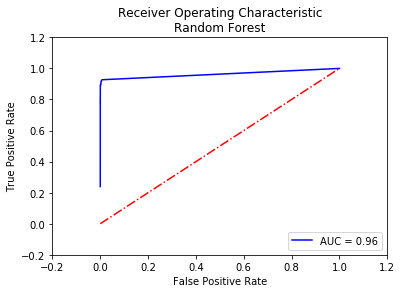

In [28]:
## Unsampled set
model.fit(X,y)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.999385555282469
Total test data points: 56962
TP  84
FP  23
TN  56843
FN  12
BCR : BALANCED CLASSIFICATION RATE  0.9372977701966025
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.875
false alarm rate  0.0004044596067949214


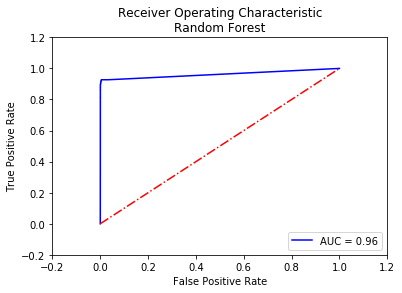

In [29]:
## UnderSampled set
model.fit(X_us,y_us)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9991924440855307
Total test data points: 56962
TP  83
FP  33
TN  56833
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9320015108617921
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8645833333333334
false alarm rate  0.0005803116097492351


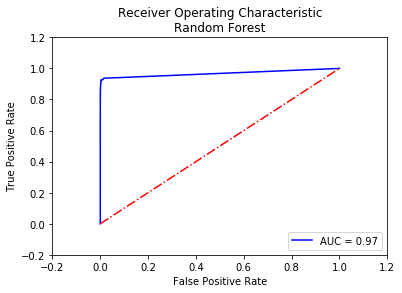

In [30]:
## Oversampled set
model.fit(X_os,y_os)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)


## Ensemble Boosting


In [31]:
## init and hyper parameters
num_trees = 150
model = AdaBoostClassifier(n_estimators=num_trees, random_state=seed)

Accuracy: 0.9993504441557529
Total test data points: 56962
TP  75
FP  16
TN  56850
FN  21
BCR : BALANCED CLASSIFICATION RATE  0.8904843183976365
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.78125
false alarm rate  0.00028136320472690185


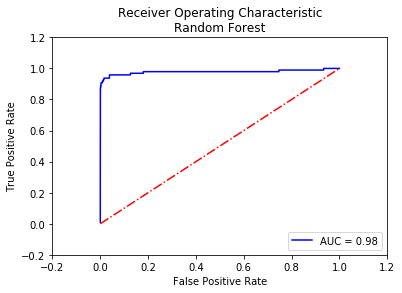

In [32]:
## Unsampled set
model.fit(X,y)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9991397773954567
Total test data points: 56962
TP  82
FP  35
TN  56831
FN  14
BCR : BALANCED CLASSIFICATION RATE  0.9267755923281633
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8541666666666666
false alarm rate  0.0006154820103400978


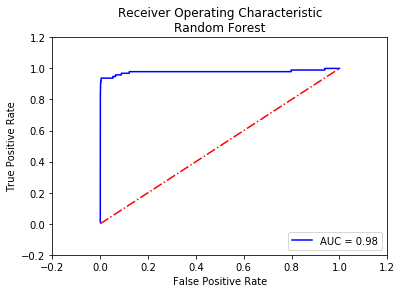

In [33]:
## UnderSampled set
model.fit(X_us,y_us)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9980864435939749
Total test data points: 56962
TP  85
FP  98
TN  56768
FN  11
BCR : BALANCED CLASSIFICATION RATE  0.9418466585188572
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8854166666666666
false alarm rate  0.0017233496289522738


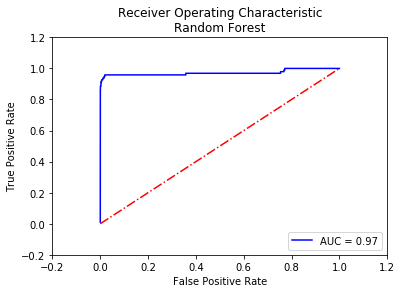

In [34]:
## Oversampled set
model.fit(X_os,y_os)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)


## Ensemble : RandomForest


In [35]:
## init and hyper parameters
num = 60
model = RandomForestClassifier(criterion='gini',n_estimators=num, random_state=seed)

Accuracy: 0.9995786664794073
Total test data points: 56962
TP  82
FP  10
TN  56856
FN  14
BCR : BALANCED CLASSIFICATION RATE  0.9269954073318561
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8541666666666666
false alarm rate  0.00017585200295431366


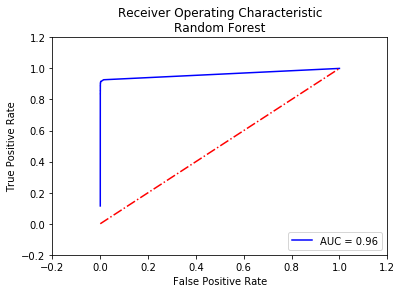

In [36]:
## Unsampled set
model.fit(X,y)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.999420666409185
Total test data points: 56962
TP  85
FP  22
TN  56844
FN  11
BCR : BALANCED CLASSIFICATION RATE  0.9425148961300835
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8854166666666666
false alarm rate  0.00038687440649949004


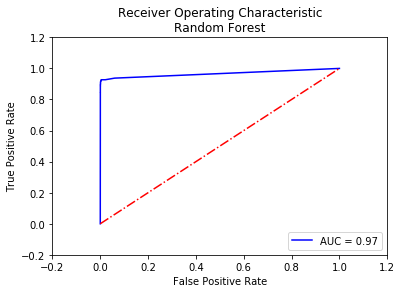

In [37]:
## UnderSampled set
model.fit(X_us,y_us)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9994908886626171
Total test data points: 56962
TP  85
FP  18
TN  56848
FN  11
BCR : BALANCED CLASSIFICATION RATE  0.9425500665306744
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8854166666666666
false alarm rate  0.0003165336053177646


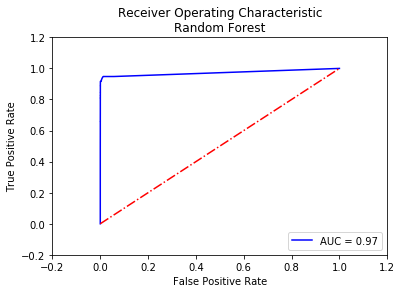

In [38]:
## Oversampled set
model.fit(X_os,y_os)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)


## kNN ( k-nearest neighbours)


In [55]:
## init and hyper parameters

model=KNeighborsClassifier(n_neighbors = 20,algorithm='kd_tree',weights='distance')

Accuracy: 0.9983848881710614
Total test data points: 56962
TP  5
FP  1
TN  56865
FN  91
BCR : BALANCED CLASSIFICATION RATE  0.526032874066519
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.052083333333333336
false alarm rate  1.7585200295431366e-05


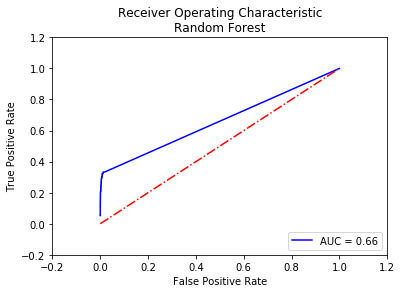

In [56]:
## Unsampled set
model.fit(X,y)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9984199992977775
Total test data points: 56962
TP  10
FP  4
TN  56862
FN  86
BCR : BALANCED CLASSIFICATION RATE  0.5520481629327425
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.10416666666666667
false alarm rate  7.034080118172546e-05


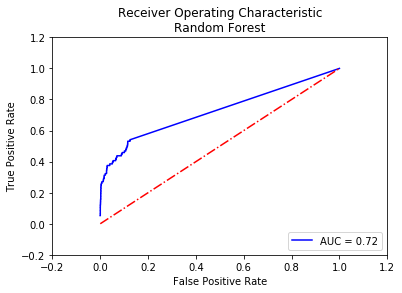

In [57]:
## UnderSampled set
model.fit(X_us,y_us)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9755275446789088
Total test data points: 56962
TP  40
FP  1338
TN  55528
FN  56
BCR : BALANCED CLASSIFICATION RATE  0.6965688343356897
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.4166666666666667
false alarm rate  0.023528997995287165


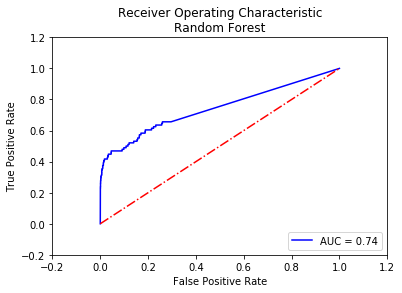

In [58]:
## Oversampled set
model.fit(X_os,y_os)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)


## Logistic Regression


In [59]:
## init and hyper parameters

model=LogisticRegression(penalty='l2', dual=False, tol=0.0001, C=1.0, fit_intercept=True, intercept_scaling=1,
                         class_weight=None, random_state=None,max_iter=500, multi_class='ovr', verbose=0,
                         warm_start=False, n_jobs=1)

Accuracy: 0.9990871107053826
Total test data points: 56962
TP  69
FP  25
TN  56841
FN  27
BCR : BALANCED CLASSIFICATION RATE  0.859155184996307
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.71875
false alarm rate  0.00043963000738578414


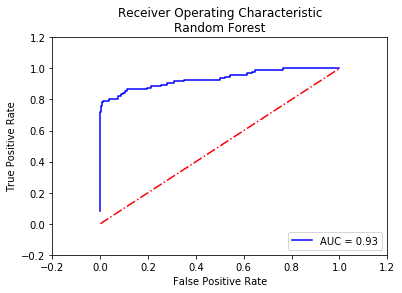

In [60]:
## Unsampled set
model.fit(X,y)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9989993328885924
Total test data points: 56962
TP  78
FP  39
TN  56827
FN  18
BCR : BALANCED CLASSIFICATION RATE  0.9059070885942391
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8125
false alarm rate  0.0006858228115218233


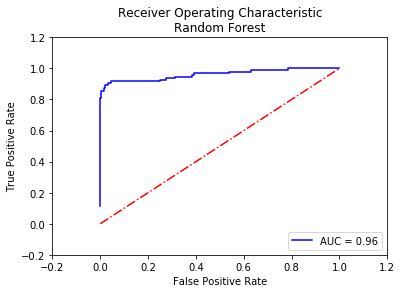

In [61]:
## UnderSampled set
model.fit(X_us,y_us)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9958217759207892
Total test data points: 56962
TP  77
FP  219
TN  56647
FN  19
BCR : BALANCED CLASSIFICATION RATE  0.8991160872343169
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8020833333333334
false alarm rate  0.003851158864699469


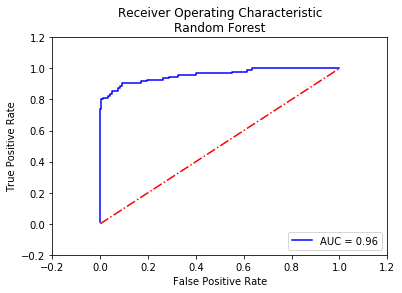

In [62]:
## Oversampled set
model.fit(X_os,y_os)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)


## Naive Bayes


In [64]:
## init and hyper parameters
model=BernoulliNB(alpha=1.0, binarize=0.0, fit_prior=True, class_prior=None)

Accuracy: 0.9990695551420246
Total test data points: 56962
TP  61
FP  18
TN  56848
FN  35
BCR : BALANCED CLASSIFICATION RATE  0.8175500665306744
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.6354166666666666
false alarm rate  0.0003165336053177646


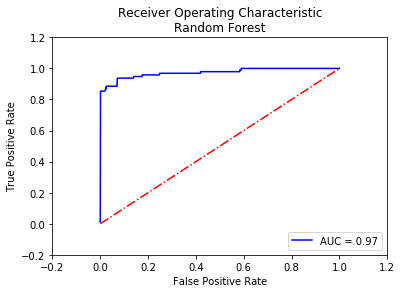

In [65]:
## Unsampled set
model.fit(X,y)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9992099996488887
Total test data points: 56962
TP  72
FP  21
TN  56845
FN  24
BCR : BALANCED CLASSIFICATION RATE  0.874815355396898
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.75
false alarm rate  0.0003692892062040587


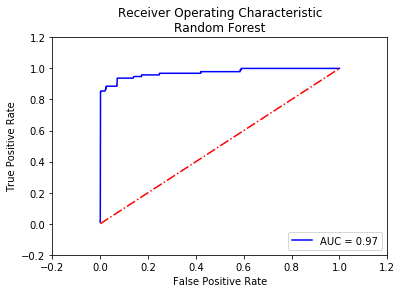

In [66]:
## UnderSampled set
model.fit(X_us,y_us)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

Accuracy: 0.9986657771847899
Total test data points: 56962
TP  79
FP  59
TN  56807
FN  17
BCR : BALANCED CLASSIFICATION RATE  0.9109395699246181
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8229166666666666
false alarm rate  0.0010375268174304506


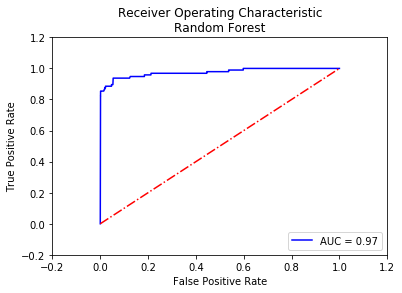

In [67]:
## Oversampled set
model.fit(X_os,y_os)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)


## Ensemble Learning ; Voting (knn,LR,NaiveB)


In [69]:
## init and hyper parameters
from sklearn.ensemble import VotingClassifier
estimators = []
model1 = LogisticRegression(penalty='l2', dual=False, tol=0.0001, C=1.0, fit_intercept=True, intercept_scaling=1, class_weight=None, random_state=None,max_iter=500, multi_class='ovr', verbose=0, warm_start=False, n_jobs=1)
estimators.append(('logistic', model1))
model2 = DecisionTreeClassifier()
estimators.append(('cart', model2))
model3=RandomForestClassifier(criterion='gini',random_state=7,n_estimators=60)
estimators.append(('RF', model3))
model4=BernoulliNB()
estimators.append(('NB', model4))
model5=AdaBoostClassifier(n_estimators=60, random_state=seed)
estimators.append(('AdB', model5))
# create the ensemble model
model = VotingClassifier(estimators,voting='soft')

c:\users\vongola\appdata\local\programs\python\python35\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


Accuracy: 0.999403110845827
Total test data points: 56962
TP  76
FP  14
TN  56852
FN  20
BCR : BALANCED CLASSIFICATION RATE  0.8957102369312653
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.7916666666666666
false alarm rate  0.0002461928041360391


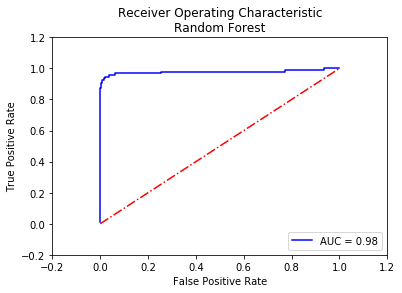

In [70]:
## Unsampled set
model.fit(X,y)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

c:\users\vongola\appdata\local\programs\python\python35\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


Accuracy: 0.999403110845827
Total test data points: 56962
TP  82
FP  20
TN  56846
FN  14
BCR : BALANCED CLASSIFICATION RATE  0.926907481330379
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8541666666666666
false alarm rate  0.0003517040059086273


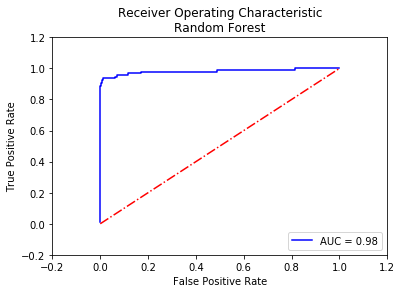

In [71]:
## UnderSampled set
model.fit(X_us,y_us)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

c:\users\vongola\appdata\local\programs\python\python35\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


Accuracy: 0.999420666409185
Total test data points: 56962
TP  85
FP  22
TN  56844
FN  11
BCR : BALANCED CLASSIFICATION RATE  0.9425148961300835
total fraud  96
total legit  56866
Recall; percentage of detected fraud  0.8854166666666666
false alarm rate  0.00038687440649949004


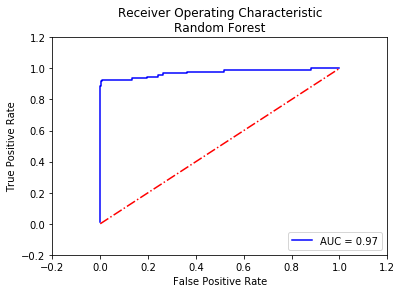

In [72]:
## Oversampled set
model.fit(X_os,y_os)
predictions=model.predict(Xt)
clftest(predictions,Xt,yt)
RoC(yt,Xt)

# Optimal Model Evaluation and Optimisation
### there are three features worth exploring with the sklearn RandomForestClassifier, in order of importance:
- **n_estimators** ,
- **max_features** ,
- **criterion**
- **class_weight**
    - n_estimators is not really worth optimizing. The more estimators you give it, the better it will do. 500 or 1000 is usually sufficient.
    - max_features is worth exploring for many different values. It may have a large impact on the behavior of the RF because it decides how many features each tree in the RF considers at each split.
    - criterion may have a small impact, but usually the default is fine.
    - class_weight important in case of unbalanced datasets


In [31]:
## init and hyper parameters
seed =77
num = 1000
model = RandomForestClassifier(criterion='gini',n_estimators=num, random_state=seed)

In [20]:
from sklearn.model_selection import GridSearchCV
model.get_params()

{'bootstrap': True,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 1000,
 'n_jobs': 1,
 'oob_score': False,
 'random_state': 7,
 'verbose': 0,
 'warm_start': False}

In [21]:
## Num Estimitors
from sklearn.metrics import roc_auc_score
num = [10,50,100,200,500]
for numt in num :
    model = RandomForestClassifier(n_estimators = numt, oob_score = False, n_jobs = 1,random_state =7,max_features = "auto", min_samples_leaf = 1)
    model.fit(X_os,y_os)
    predictions=model.predict(Xt)
    print("for {} of trees".format(numt))
    clftest(predictions,Xt,yt)

        
     

for 10 of trees
Accuracy: 0.9995611109160493
Total test data points: 56962
TP  88
FP  10
TN  56849
FN  15
BCR : BALANCED CLASSIFICATION RATE  0.9270965291932334
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8543689320388349
false alarm rate  0.00017587365236813873
for 50 of trees
Accuracy: 0.9995786664794073
Total test data points: 56962
TP  90
FP  11
TN  56848
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9367964733746926
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8737864077669902
false alarm rate  0.0001934610176049526
for 100 of trees
Accuracy: 0.9995786664794073
Total test data points: 56962
TP  90
FP  11
TN  56848
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9367964733746926
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8737864077669902
false alarm rate  0.0001934610176049526
for 200 of trees
Accuracy: 0.9995786664794073
Total test data points: 56962
TP  90
FP  11
TN  56848
FN  13
BCR : BAL

**seems like more than a 50 trees is just a waste of computation **

In [22]:
## Max Features
from sklearn.metrics import roc_auc_score
Max = [8,'sqrt','log2',None]
for f in Max :
    model = RandomForestClassifier(n_estimators = 50, oob_score = False, n_jobs = 1,random_state =7,max_features = f, min_samples_leaf = 1)
    model.fit(X_os,y_os)
    predictions=model.predict(Xt)
    print("for {} type of max features".format(f))
    clftest(predictions,Xt,yt)

        
     

for 8 type of max features
Accuracy: 0.9995611109160493
Total test data points: 56962
TP  90
FP  12
TN  56847
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9367876796920742
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8737864077669902
false alarm rate  0.00021104838284176648
for sqrt type of max features
Accuracy: 0.9995786664794073
Total test data points: 56962
TP  90
FP  11
TN  56848
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9367964733746926
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8737864077669902
false alarm rate  0.0001934610176049526
for log2 type of max features
Accuracy: 0.9995786664794073
Total test data points: 56962
TP  90
FP  11
TN  56848
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9367964733746926
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8737864077669902
false alarm rate  0.0001934610176049526
for None type of max features
Accuracy: 0.9993153330290369
Total test data poi

Max feature <- sqrt

In [23]:
#criterion
Max = ['gini','entropy']
for f in Max :
    model = RandomForestClassifier(n_estimators =50, oob_score = False, n_jobs = 1,random_state =7,max_features ='sqrt', min_samples_leaf = 1,criterion=f)
    model.fit(X_os,y_os)
    predictions=model.predict(Xt)
    print("for {} type of criterion".format(f))
    clftest(predictions,Xt,yt)

for gini type of criterion
Accuracy: 0.9995786664794073
Total test data points: 56962
TP  90
FP  11
TN  56848
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9367964733746926
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8737864077669902
false alarm rate  0.0001934610176049526
for entropy type of criterion
Accuracy: 0.9995611109160493
Total test data points: 56962
TP  90
FP  12
TN  56847
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9367876796920742
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8737864077669902
false alarm rate  0.00021104838284176648


**criterion <- gini**

In [24]:
#class weight
Max = ['balanced_subsample',None,'balanced',]
for f in Max :
    model = RandomForestClassifier(class_weight=f,n_estimators = 50, oob_score = False, n_jobs = 1,random_state =7,max_features ='sqrt', min_samples_leaf = 1,criterion='gini')
    model.fit(X_os,y_os)
    predictions=model.predict(Xt)
    print("for {} type of Class weight".format(f))
    clftest(predictions,Xt,yt)

for balanced_subsample type of Class weight
Accuracy: 0.9996137776061234
Total test data points: 56962
TP  88
FP  7
TN  56852
FN  15
BCR : BALANCED CLASSIFICATION RATE  0.9271229102410886
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8543689320388349
false alarm rate  0.00012311155665769712
for None type of Class weight
Accuracy: 0.9995786664794073
Total test data points: 56962
TP  90
FP  11
TN  56848
FN  13
BCR : BALANCED CLASSIFICATION RATE  0.9367964733746926
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8737864077669902
false alarm rate  0.0001934610176049526
for balanced type of Class weight
Accuracy: 0.9996313331694814
Total test data points: 56962
TP  89
FP  7
TN  56852
FN  14
BCR : BALANCED CLASSIFICATION RATE  0.9319772791731274
total fraud  103
total legit  56859
Recall; percentage of detected fraud  0.8640776699029126
false alarm rate  0.00012311155665769712


**None it is**

In [49]:
%%time
model = RandomForestClassifier(n_estimators = 50, oob_score = True, n_jobs = 1,random_state =7,max_features ='sqrt', min_samples_leaf = 1,criterion='gini')
model.fit(X_us,y_us)

Wall time: 10.2 s


Accuracy: 0.9999668852241871
Total test data points: 30198
TP  297
FP  0
TN  29900
FN  1
BCR : BALANCED CLASSIFICATION RATE  0.9983221476510067
total fraud  298
total legit  29900
Recall; percentage of detected fraud  0.9966442953020134
false alarm rate  0.0


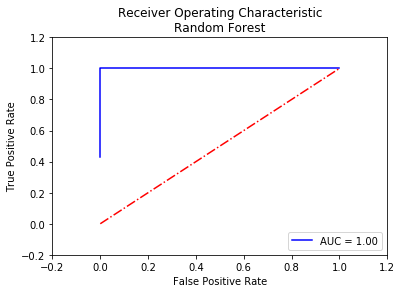

Wall time: 938 ms


In [50]:
%%time
predictions=model.predict(X_us)
clftest(predictions,X_us,y_us)
RoC(y_us,X_us)

## Validation test

Accuracy: 0.9995259914678464
Total test data points: 56961
TP  89
FP  17
TN  56845
FN  10
BCR : BALANCED CLASSIFICATION RATE  0.9493454647775635
total fraud  99
total legit  56862
Recall; percentage of detected fraud  0.898989898989899
false alarm rate  0.0002989694347719039


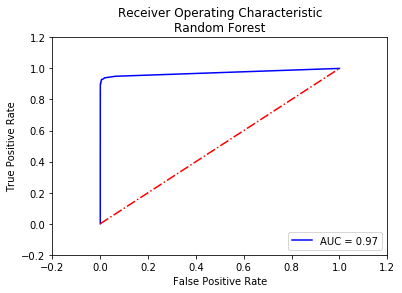

Wall time: 1.58 s


In [51]:
%%time
## Validation Test
predictions=model.predict(Xv)
clftest(predictions,Xv,yv)
RoC(yv,Xv)
## 